## 클러스터링 기반 대표부하 선정


### 데이터 로드

In [1]:
# SAVE 데이터 로드
import os
os.chdir('../')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from module.util_main import downsampling, dim_reduct
from collections import defaultdict
font = {'size': 16, 'family':"Malgun Gothic"}
matplotlib.rc('font', **font)

from pathlib import Path

### 에너지 데이터 로드
SAVE = pd.read_csv('data/SAVE/power_0428.csv', index_col=0)
SAVE = SAVE.iloc[84:,:]
SAVE.index = pd.to_datetime(SAVE.index)
SAVE[SAVE == 0] = np.nan
SAVE = SAVE.loc[pd.to_datetime('2017-01-01 00:00'):,:]

helper_dict = defaultdict(list)
for col in SAVE.columns:
    helper_dict[col[2:]].append(col)

# 동일 집끼리 병합
drop_cols = []
invalid_idx_list = []
for key,value in helper_dict.items():
    if len(value) >= 2:
        valid_idx_1 = ~pd.isnull(SAVE[value[1]])

        # replace value
        SAVE[value[0]][valid_idx_1] = SAVE[value[1]][valid_idx_1]

        # delete remain
        drop_cols.append(value[1])

# drop cols
SAVE.drop(columns = drop_cols, inplace = True)

# label과 data의 column 맞춤
SAVE.columns = [c[2:] for c in SAVE.columns]

### 라벨 로드
SAVE_label = pd.read_csv('data/SAVE/save_household_survey_data_v0-3.csv', index_col = 0)
# Interviedate가 빠른 순으로 정렬
SAVE_label.sort_values('InterviewDate', inplace = True)
SAVE_label = SAVE_label.T
SAVE_label.columns = SAVE_label.columns.astype(str)

# 라벨 순서를 데이터 순서와 맞춤
valid_col = []
for col in SAVE.columns:
    if col in SAVE_label.columns:
        valid_col.append(col)

SAVE_label = SAVE_label[valid_col].T
SAVE = SAVE[valid_col]
print('Done load SAVE')
SAVE[SAVE == 0] = np.nan

# CER 데이터 로드
# %% load dataset
# start_date = pd.to_datetime('2010-09-01 00:00:00')
# end_date = pd.to_datetime('2009-12-01 23:00:00')

power_df = pd.read_csv('data/CER/power_comb_SME_included.csv')

# 0 to NaN
power_df[power_df==0] = np.nan
power_df['time'] = pd.to_datetime(power_df['time'])
power_df.set_index('time', inplace=True)

# load label
CER_label = pd.read_csv('data/CER/survey_processed_0427.csv')
CER_label['ID'] = CER_label['ID'].astype(str)
CER_label.set_index('ID', inplace=True)

CER = power_df.loc[:,CER_label.index]
del power_df
print('Done load CER')

## 기간을 6개월 한정
start_date = pd.to_datetime('2018-01-01 00:00:00')
end_date = pd.to_datetime('2018-06-30 23:45:00')

SAVE = SAVE.loc[start_date:end_date,:]

start_date = pd.to_datetime('2010-01-01 00:00:00')
end_date = pd.to_datetime('2010-06-30 23:30:00')

CER = CER.loc[start_date:end_date,:]

# Downsampling SAVE
n = SAVE.shape[0]
list_ = []
time_ = []
for i in range(0, n, 2):
    data = SAVE.iloc[i:i+2,:]
    invalid_data_idx = np.any(pd.isnull(data), axis=0)
    data = data.sum(axis=0)
    data.iloc[invalid_data_idx] = np.nan
    list_.append(data)
    time_.append(SAVE.index[i])
list_ = pd.concat(list_, axis=1).T
list_.index = time_
SAVE = list_
del list_

print(SAVE.shape)
print(CER.shape)

Done load SAVE
Done load CER
(8688, 3934)
(8688, 4232)


### nan밖에 업는 집 필터링

In [3]:
nan_ratio = pd.isnull(SAVE).sum(axis=0) / SAVE.shape[0]
invalid_idx = (nan_ratio == 1)
SAVE = SAVE.loc[:,~invalid_idx]
SAVE_label = SAVE_label.loc[~invalid_idx,:]

In [4]:
nan_ratio = pd.isnull(CER).sum(axis=0) / CER.shape[0]
invalid_idx = (nan_ratio == 1)
CER = CER.loc[:,~invalid_idx]
CER_label = CER_label.loc[~invalid_idx,:]

In [ ]:
print(SAVE.shape)
print(CER.shape)

## daily로 변환

In [5]:
def transform(df, sampling_interv = 24 * 2 * 7):
    n_d, n_h = df.shape
    n_w = n_d // sampling_interv
    n_d = n_w * sampling_interv
    df_rs = df.iloc[:n_d,:].values.T.reshape(n_h,-1, sampling_interv)
    return df_rs
SAVE_rs = transform(SAVE, 24 * 2)
CER_rs = transform(CER, 24 * 2)

In [6]:
n, m, l = CER_rs.shape
CER_rs = CER_rs.reshape(n*m, l)

home_arr = np.repeat(np.arange(0, n), m)
invalid_idx = np.any(pd.isnull(CER_rs), axis=1)
CER_rs = CER_rs[~invalid_idx, :]
home_arr = home_arr[~invalid_idx]

In [ ]:
clusterig_result = dict()
model_dict = dict()
from tslearn.clustering import TimeSeriesKMeans, KShape
from tqdm import tqdm

for n_clusters in tqdm(range(2, 20)):
    # 1. KMeans
    model = TimeSeriesKMeans(n_clusters = n_clusters, metric = 'euclidean', \
        max_iter = 10000000, random_state = 0, verbose = 1, n_jobs=-1)
    result = model.fit_predict(CER_rs)
    model_dict['euc_' + str(n_clusters)] = model
    clusterig_result['euc_' + str(n_clusters)] = result

### clustering 결과 검증

1. DB index

In [7]:
from sklearn.metrics import davies_bouldin_score

result = []
for n_clusters in range(2, 20):
    db_index = davies_bouldin_score(CER_rs, clusterig_result['euc_'+str(n_clusters)])
    result.append(db_index)


findfont: Font family ['Malgun Gothic'] not found. Falling back to DejaVu Sans.


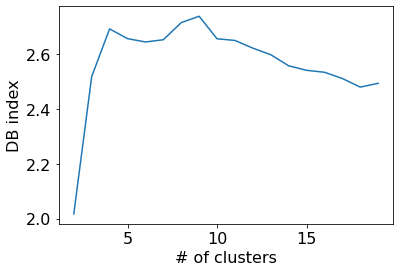

In [8]:
plt.figure()
plt.plot(range(2, 20), result)
plt.xlabel('# of clusters')
plt.ylabel('DB index')
plt.show()

In [21]:
!pip install git+https://github.com/jqmviegas/jqm_cvi.git 

  Cloning https://github.com/jqmviegas/jqm_cvi.git to /tmp/pip-req-build-dk69c71q
  Running command git clone -q https://github.com/jqmviegas/jqm_cvi.git /tmp/pip-req-build-dk69c71q
  Created wheel for jqmcvi: filename=jqmcvi-1.0-cp36-cp36m-linux_x86_64.whl size=261647 sha256=293c65fa27050a5cd239c4cb0cae44704a3393ac76c770fee5cc089905a24ba4
  Stored in directory: /tmp/pip-ephem-wheel-cache-de6zh4uf/wheels/a9/fb/16/91144389e0bb2ef97684e70c658007f20ae8d582b92d85db39
Successfully built jqmcvi


# normalization 후 클러스터링

In [9]:
# normalization
CER_rs_n = CER_rs.copy()
home_arr_n = home_arr.copy()

invalid_idx = np.nanmin(CER_rs_n, axis=1) == np.nanmax(CER_rs_n, axis=1)

CER_rs_n = CER_rs_n[~invalid_idx, :]
home_arr_n = home_arr_n[~invalid_idx]

min_ = np.nanmin(CER_rs_n, axis=1).reshape(-1,1)
max_ = np.nanmax(CER_rs_n, axis=1).reshape(-1,1)
CER_rs_n = (CER_rs_n - min_)/(max_ - min_)

In [136]:
from tqdm import tqdm
from tslearn.clustering import TimeSeriesKMeans, KShape

for n_clusters in tqdm(range(14,20)):
    # 1. KMeans
    model = TimeSeriesKMeans(n_clusters = n_clusters, metric = 'euclidean', \
        max_iter = 10000000, random_state = 0, verbose = 1, n_jobs=-1)
    result = model.fit_predict(CER_rs_n)
    model_dict['euc_n_' + str(n_clusters)] = model
    clusterig_result['euc_n_' + str(n_clusters)] = result

 17%|█▋        | 1/6 [54:13<4:31:08, 3253.71s/it]


KeyboardInterrupt: 

In [137]:
from sklearn.metrics import davies_bouldin_score

result_n = []
for n_clusters in range(2, 15):
    db_index = davies_bouldin_score(CER_rs_n, clusterig_result['euc_n_'+str(n_clusters)])
    result_n.append(db_index)

plt.figure()
plt.plot(range(2, 15), result_n)
plt.xlabel('# of clusters')
plt.ylabel('DB index')
plt.show()

## 대표부하 비교/분석

In [18]:
path = 'data/CER/'
survey_raw = pd.read_csv(path + 'Smart meters Residential pre-trial survey data.csv', encoding='cp1252', low_memory=False)
survey_raw.set_index('ID', inplace=True)
# replace blanks
for j in range(survey_raw.shape[1]):
    for i in range(survey_raw.shape[0]):
        try:
            int(survey_raw.iloc[i, j])
        except:
            survey_raw.iloc[i, j] = -1

for j in range(survey_raw.shape[1]):
    survey_raw.iloc[:, j] = survey_raw.iloc[:, j].astype(int)

# processed survey data
survey = pd.DataFrame(index = survey_raw.index)

Q49002 = ['Question 49002: Washing machine',
'Question 49002: Tumble dryer',
'Question 49002: Dishwasher',
'Question 49002: Electric shower (instant)',
'Question 49002: Electric shower (electric pumped from hot tank)',
'Question 49002: Electric cooker',
'Question 49002: Electric heater (plug-in convector heaters)',
'Question 49002: Stand alone freezer',
'Question 49002: A water pump or electric well pump or pressurised water system',
'Question 49002: Immersion']
Q490002=[
'Question 490002: TV’s less than 21 inch',
'Question 490002: TV’s greater than 21 inch',
'Question 490002: Desk-top computers',
'Question 490002: Lap-top computers',
'Question 490002: Games consoles, such as xbox, playstation or Wii']

survey['Q12'] = 0
for Question in Q49002:
    val = survey_raw.loc[:,Question].values.copy()
    val[val<=1] = 0
    val[val == 2] = 1
    val[val == 3] = 2
    val[val == 4] = 3
    survey['Q12'] += val

for Question in Q490002:
    val = survey_raw.loc[:,Question].values.copy()
    val[val<=1] = 0
    val[val == 2] = 1
    val[val == 3] = 2
    val[val == 4] = 3
    val[val == 5] = 4
    survey['Q12'] += val

survey.index = survey.index.astype(str)
CER_label['Q12'] = survey.loc[CER_label.index,'Q12']

In [144]:
rep_load_dict = dict()
label_dict = dict()
n_points_list = []
CER_rs = transform(CER, 24 * 2)

label = CER_label['Q13'].values
# label = CER_label['Q12'].values

### 6달 평균
data_list, label_list = [], []
for house_idx in range(CER.shape[1]):
    data = np.nanmean(CER_rs[house_idx, :,:], axis=0)
    if pd.isnull(data).sum():
        continue
    data_list.append(data)
    label_list.append(label[house_idx])
data = np.array(data_list)
label_list = np.array(label_list)
rep_load_dict['6 month avg'] = data
label_dict['6 month avg'] = label_list
n_points_list.append(data.shape[0])

### 3달 평균
data_list, label_list = [], []
for house_idx in range(CER.shape[1]):
    data = np.nanmean(CER_rs[house_idx, :100,:], axis=0)
    if pd.isnull(data).sum():
        continue
    data_list.append(data)
    label_list.append(label[house_idx])
data = np.array(data_list)
rep_load_dict['3 month avg'] = data
label_dict['3 month avg'] = label_list
n_points_list.append(data.shape[0])

### 1달 평균
data_list, label_list = [], []
for house_idx in range(CER.shape[1]):
    data = np.nanmean(CER_rs[house_idx, :31,:], axis=0)
    if pd.isnull(data).sum():
        continue
    data_list.append(data)
    label_list.append(label[house_idx])
data = np.array(data_list)
rep_load_dict['1 month avg 1'] = data
label_dict['1 month avg 1'] = label_list
n_points_list.append(data.shape[0])

### 1달 평균
data_list, label_list = [], []
for house_idx in range(CER.shape[1]):
    data = np.nanmean(CER_rs[house_idx, -31:,:], axis=0)
    if pd.isnull(data).sum():
        continue
    data_list.append(data)
    label_list.append(label[house_idx])
data = np.array(data_list)
rep_load_dict['1 month avg 2'] = data
label_dict['1 month avg 2'] = label_list
n_points_list.append(data.shape[0])

label = CER_label['Q13'].values
# label = CER_label['Q12'].values
CER_recon = CER_rs_n * (max_ - min_) + min_ # inverse normalization
unique_home_arr = np.unique(home_arr_n)
rep_load_list, label_list = [], []
for h in unique_home_arr:
    idx1 = home_arr_n == h
    v, c= np.unique(clusterig_result['euc_n_14'][idx1], return_counts=True)
    rep_c = v[np.argmax(c)]
    idx2 = clusterig_result['euc_n_14'] == rep_c

    idx = idx1 * idx2

    rep_load_list.append(CER_recon[idx,:].mean(axis=0))
    label_list.append(label[h])

rep_load_dict['kmeans-14 + N'] = np.array(rep_load_list)
label_dict['kmeans-14 + N'] = np.array(label_list)
n_points_list.append(len(rep_load_list))



# rep_load_list, label_list = [], []
# for h in unique_home_arr:
#     idx1 = home_arr_n == h
#     v, c= np.unique(clusterig_result['euc_n_2'][idx1], return_counts=True)
#     rep_c = v[np.argmax(c)]
#     idx2 = clusterig_result['euc_n_2'] == rep_c

#     idx = idx1 * idx2

#     rep_load_list.append(CER_recon[idx,:].mean(axis=0))
#     label_list.append(label[h])

# rep_load_dict['kmeans-2 + N'] = np.array(rep_load_list)
# label_dict['kmeans-2 + N'] = np.array(label_list)
# n_points_list.append(len(rep_load_list))

rep_load_list, label_list = [], []
for h in unique_home_arr:
    idx1 = home_arr_n == h
    v, c= np.unique(clusterig_result['euc_n_4'][idx1], return_counts=True)
    rep_c = v[np.argmax(c)]
    idx2 = clusterig_result['euc_n_4'] == rep_c

    idx = idx1 * idx2

    rep_load_list.append(CER_recon[idx,:].mean(axis=0))
    label_list.append(label[h])

    rep_load_dict['kmeans-4 + N'] = np.array(rep_load_list)
label_dict['kmeans-4 + N'] = np.array(label_list)
n_points_list.append(len(rep_load_list))


# n, m, l = CER_rs.shape
# CER_rs = CER_rs.reshape(n*m, l)
# home_arr = np.repeat(np.arange(0, n), m)
# invalid_idx = np.any(pd.isnull(CER_rs), axis=1)
# CER_rs = CER_rs[~invalid_idx, :]
# home_arr = home_arr[~invalid_idx]
# unique_home_arr = np.unique(home_arr)

# rep_load_list, label_list = [], []
# for h in unique_home_arr:
#     idx1 = home_arr == h
#     v, c= np.unique(clusterig_result['euc_2'][idx1], return_counts=True)
#     rep_c = v[np.argmax(c)]
#     idx2 = clusterig_result['euc_2'] == rep_c

#     idx = idx1 * idx2

#     rep_load_list.append(CER_rs[idx,:].mean(axis=0))
#     label_list.append(label[h])

# rep_load_dict['kmeans-2 w/o N'] = np.array(rep_load_list)
# label_dict['kmeans-2 w/o N'] = np.array(label_list)
# n_points_list.append(len(rep_load_list))


ipykernel_launcher:26: RuntimeWarning: Mean of empty slice
ipykernel_launcher:39: RuntimeWarning: Mean of empty slice
ipykernel_launcher:52: RuntimeWarning: Mean of empty slice


In [145]:
rep_load_dict = dict()
label_dict = dict()
n_points_list = []
CER_rs = transform(CER, 24 * 2)

label = CER_label['Q13'].values
# label = CER_label['Q12'].values

### 6달 평균
data_list, label_list = [], []
for house_idx in range(CER.shape[1]):
    data = np.nanmean(CER_rs[house_idx, :,:], axis=0)
    if pd.isnull(data).sum():
        continue
    data_list.append(data)
    label_list.append(label[house_idx])
data = np.array(data_list)
label_list = np.array(label_list)
rep_load_dict['6 month avg'] = data
label_dict['6 month avg'] = label_list
n_points_list.append(data.shape[0])

### 3달 평균
data_list, label_list = [], []
for house_idx in range(CER.shape[1]):
    data = np.nanmean(CER_rs[house_idx, :100,:], axis=0)
    if pd.isnull(data).sum():
        continue
    data_list.append(data)
    label_list.append(label[house_idx])
data = np.array(data_list)
rep_load_dict['3 month avg'] = data
label_dict['3 month avg'] = label_list
n_points_list.append(data.shape[0])

### 1달 평균
data_list, label_list = [], []
for house_idx in range(CER.shape[1]):
    data = np.nanmean(CER_rs[house_idx, :31,:], axis=0)
    if pd.isnull(data).sum():
        continue
    data_list.append(data)
    label_list.append(label[house_idx])
data = np.array(data_list)
rep_load_dict['1 month avg 1'] = data
label_dict['1 month avg 1'] = label_list
n_points_list.append(data.shape[0])

### 1달 평균
data_list, label_list = [], []
for house_idx in range(CER.shape[1]):
    data = np.nanmean(CER_rs[house_idx, -31:,:], axis=0)
    if pd.isnull(data).sum():
        continue
    data_list.append(data)
    label_list.append(label[house_idx])
data = np.array(data_list)
rep_load_dict['1 month avg 2'] = data
label_dict['1 month avg 2'] = label_list
n_points_list.append(data.shape[0])

label = CER_label['Q13'].values
# label = CER_label['Q12'].values
CER_recon = CER_rs_n * (max_ - min_) + min_ # inverse normalization
unique_home_arr = np.unique(home_arr_n)
rep_load_list, label_list = [], []
for h in unique_home_arr:
    idx1 = home_arr_n == h
    v, c= np.unique(clusterig_result['euc_n_14'][idx1], return_counts=True)
    rep_c = v[np.argmax(c)]
    idx2 = clusterig_result['euc_n_14'] == rep_c

    # idx = idx1 * idx2
    idx = idx2

    rep_load_list.append(CER_recon[idx,:].mean(axis=0))
    label_list.append(label[h])

rep_load_dict['kmeans-14 + N'] = np.array(rep_load_list)
label_dict['kmeans-14 + N'] = np.array(label_list)
n_points_list.append(len(rep_load_list))

# rep_load_list, label_list = [], []
# for h in unique_home_arr:
#     idx1 = home_arr_n == h
#     v, c= np.unique(clusterig_result['euc_n_2'][idx1], return_counts=True)
#     rep_c = v[np.argmax(c)]
#     idx2 = clusterig_result['euc_n_2'] == rep_c

#     # idx = idx1 * idx2
#     idx = idx2

#     rep_load_list.append(CER_recon[idx,:].mean(axis=0))
#     label_list.append(label[h])

# rep_load_dict['kmeans-2 + N'] = np.array(rep_load_list)
# label_dict['kmeans-2 + N'] = np.array(label_list)
# n_points_list.append(len(rep_load_list))

rep_load_list, label_list = [], []
for h in unique_home_arr:
    idx1 = home_arr_n == h
    v, c= np.unique(clusterig_result['euc_n_4'][idx1], return_counts=True)
    rep_c = v[np.argmax(c)]
    idx2 = clusterig_result['euc_n_4'] == rep_c

    # idx = idx1 * idx2
    idx = idx2

    rep_load_list.append(CER_recon[idx,:].mean(axis=0))
    label_list.append(label[h])

rep_load_dict['kmeans-4 + N'] = np.array(rep_load_list)
label_dict['kmeans-4 + N'] = np.array(label_list)
n_points_list.append(len(rep_load_list))

# n, m, l = CER_rs.shape
# CER_rs = CER_rs.reshape(n*m, l)
# home_arr = np.repeat(np.arange(0, n), m)
# invalid_idx = np.any(pd.isnull(CER_rs), axis=1)
# CER_rs = CER_rs[~invalid_idx, :]
# home_arr = home_arr[~invalid_idx]
# unique_home_arr = np.unique(home_arr)

# rep_load_list, label_list = [], []
# for h in unique_home_arr:
#     idx1 = home_arr == h
#     v, c= np.unique(clusterig_result['euc_2'][idx1], return_counts=True)
#     rep_c = v[np.argmax(c)]
#     idx2 = clusterig_result['euc_2'] == rep_c

#     # idx = idx1 * idx2
#     idx = idx2

#     rep_load_list.append(CER_rs[idx,:].mean(axis=0))
#     label_list.append(label[h])

# rep_load_dict['kmeans-2 w/o N'] = np.array(rep_load_list)
# label_dict['kmeans-2 w/o N'] = np.array(label_list)
# n_points_list.append(len(rep_load_list))


ipykernel_launcher:26: RuntimeWarning: Mean of empty slice
ipykernel_launcher:39: RuntimeWarning: Mean of empty slice
ipykernel_launcher:52: RuntimeWarning: Mean of empty slice


In [102]:
rep_load_list, label_list = [], []
for h in unique_home_arr:
    idx1 = home_arr == h
    v, c= np.unique(clusterig_result['euc_2'][idx1], return_counts=True)
    rep_c = v[np.argmax(c)]
    idx2 = clusterig_result['euc_2'] == rep_c

    # idx = idx1 * idx2
    idx = idx2

    rep_load_list.append(CER_rs[idx,:].mean(axis=0))
    label_list.append(label[h])

rep_load_dict['kmeans-2 w/o N'] = np.array(rep_load_list[:-1])
label_dict['kmeans-2 w/o N'] = np.array(label_list)
n_points_list.append(len(rep_load_list))

IndexError: index 3243 is out of bounds for axis 0 with size 3243

In [111]:
rep_load_dict['kmeans-2 w/o N'] = np.array(rep_load_list[:-1])
label_dict['kmeans-2 w/o N'] = np.array(label_list)
n_points_list.append(len(rep_load_list))

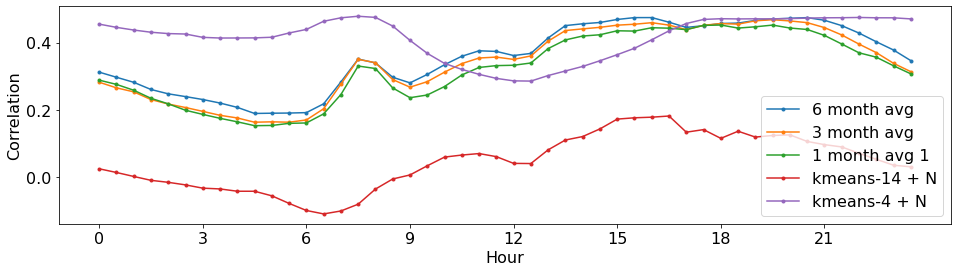

In [146]:
plt.figure(figsize = (16,4))
for key in rep_load_dict.keys():
    data = rep_load_dict[key]
    label = label_dict[key]
    corr_list = []
    if key == '1 month avg 2':
        continue
    for j in range(48):
        corr_list.append(np.corrcoef(data[:,j], np.ravel(label))[0,1])
    # print(key)
    # print(corr_list)
    plt.plot(corr_list, '.-',label = key)
plt.legend()
plt.xlabel('Hour')
plt.xticks(range(48)[::6], (np.array(range(48))/2)[::6].astype(int))
plt.ylabel('Correlation')
plt.show()

In [78]:
def calc_MI_corr(data, label, is_categorical):
    ## MI
    val, count = np.unique(label, return_counts=True)
    prob = count / count.sum()

    sig_ = np.std(data)
    H_X = 1 / 2 * np.log2(2 * np.pi * np.e * sig_ ** 2)

    H_con = 0
    for ii, v in enumerate(val):
        sig_ = np.std(data[label == v])
        if sig_ == 0:
            pass
        else:
            H_con += (1 / 2 * np.log2(2 * np.pi * np.e * sig_ ** 2)) * prob[ii]
    MI = H_X - H_con

    ## corr
    if is_categorical and list(val)!=[0,1]:
        corr_ = 0
        for ii, v in enumerate(val):
            corr_ += np.abs(np.corrcoef(np.ravel(data), np.ravel(label==v))[0,1]) * prob[ii]
    else:
        print('Not categorical')
        corr_ = np.abs(np.corrcoef(np.ravel(data), np.ravel(label))[0,1])
    return [MI, corr_]

calc_MI_corr(data.mean(axis=1), np.ravel(label), False)

Not categorical


[0.25424384152289664, 0.47132587038787815]

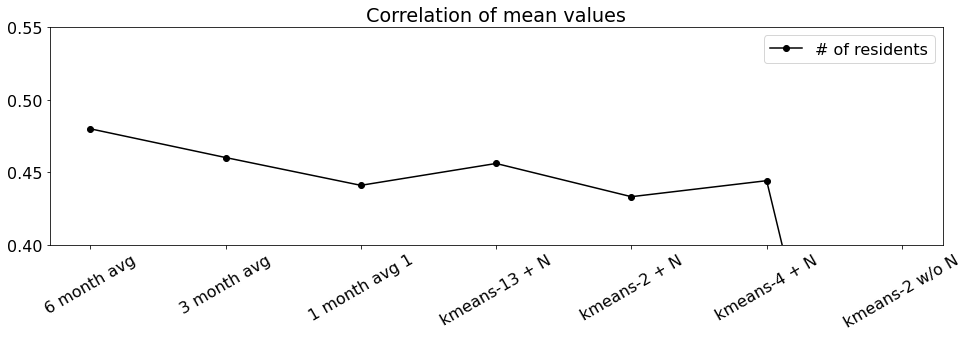

In [128]:
plt.figure(figsize = (16,4))
plt.title('Correlation of mean values')
corr_list_2 = []
key_list = []
for key in rep_load_dict.keys():
    if key == '1 month avg 2':
        continue
    data = rep_load_dict[key]
    label = label_dict[key]
    corr_list_2.append(np.corrcoef(data.mean(axis=1), label)[0,1])
    key_list.append(key)
plt.plot(range(len(corr_list_2)), corr_list_2,'ko-', label = '# of residents')
# plt.plot(range(len(corr_list)), corr_list,'rx-', label = '# of residents')
# plt.legend()
# plt.xlabel('Hour')
plt.xticks(range(len(corr_list_2)),key_list, rotation = 30)
plt.legend()
plt.ylim(0.4, 0.55)
# plt.ylabel('Correlation')
plt.show()

Not categorical
Not categorical
Not categorical
Not categorical
Not categorical
Not categorical
Not categorical


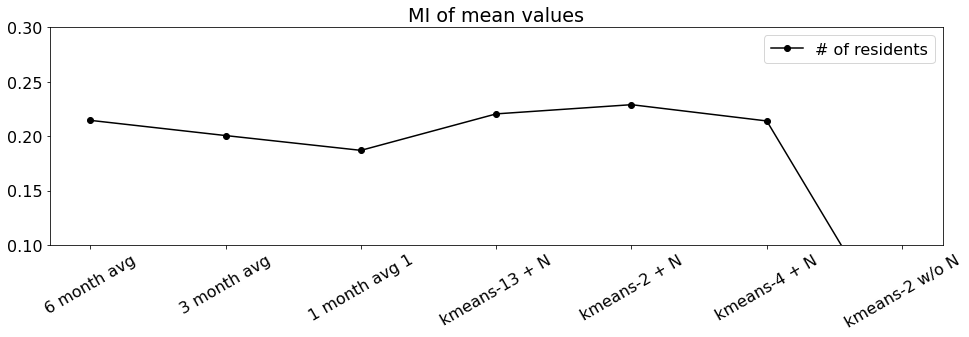

In [126]:
plt.figure(figsize = (16,4))
plt.title('MI of mean values')
MI_result = []
key_list = []
for key in rep_load_dict.keys():
    if key == '1 month avg 2':
        continue
    key_list.append(key)
    data = rep_load_dict[key]
    label = label_dict[key]
    MI_result.append(calc_MI_corr(data.mean(axis=1), np.ravel(label), False)[0])
plt.plot(range(len(MI_result)), MI_result,'ko-', label = '# of residents')
# plt.plot(range(len(MI_result_2)), MI_result_2,'rx-', label = '# of residents')
# plt.legend()
# plt.xlabel('Hour')
plt.xticks(range(len(MI_result)),key_list, rotation = 30)
plt.legend()
plt.ylim(0.1, 0.3)
# plt.ylabel('Correlation')
plt.show()

In [49]:
corr_list

[0.49489096928399723,
 0.47725282621038345,
 0.459564530291504,
 0.5174726526720181,
 0.45910575630959516,
 0.4718234643999443,
 0.45119315507570057,
 0.47132587038787815]

In [174]:
import pickle

with open('model_dict.pickle', 'wb') as handle:
    pickle.dump(model_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)


with open('clusterig_result.pickle', 'wb') as handle:
    pickle.dump(clusterig_result, handle, protocol=pickle.HIGHEST_PROTOCOL)



In [2]:
import pickle

with open('model_dict.pickle', 'rb') as handle:
    model_dict = pickle.load(handle)

with open('clusterig_result.pickle', 'rb') as handle:
    clusterig_result = pickle.load(handle)

/home/ubuntu/anaconda3/envs/mskim/lib/python3.6/site-packages/tslearn/clustering/kmeans.py:17: UserWarning: Scikit-learn <0.24 will be deprecated in a future release of tslearn
  "Scikit-learn <0.24 will be deprecated in a "


### clustering 결과 시각화

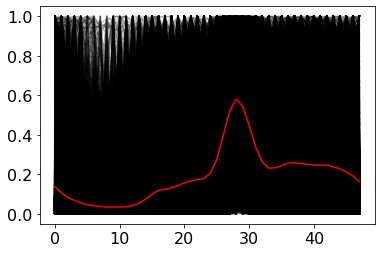

In [123]:
# label = CER_label['Q12'].values
CER_recon = CER_rs_n * (max_ - min_) + min_ # inverse normalization
plt.figure()
for i in range(13):
    idx = clusterig_result['euc_n_13'] == i
    plt.plot(CER_rs_n[idx,:].T, 'k',alpha = 0.2)
    plt.plot(CER_rs_n[idx,:].mean(axis=0).T,'r')
    plt.show()
    break


## Partitioning해서 clustering

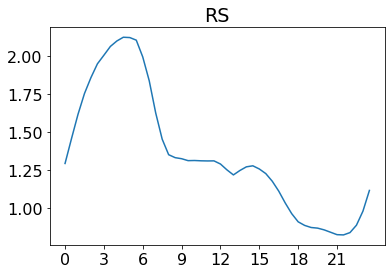

In [157]:
plt.title('RSD')
plt.plot(np.nanstd(CER_rs_n, axis=0) / np.nanmean(CER_rs_n, axis=0))
plt.xticks(range(48)[::6], (np.array(range(48))/2)[::6].astype(int))
plt.show()

In [165]:
idx1 = list(range(0, 9*2)) + list(range(18*2, 48))
idx2 = list(range(9*2, 18*2))
CER_rs_n_p1 = CER_rs_n[:,idx1]
CER_rs_n_p2 = CER_rs_n[:,idx2]

CER_rs_n_p1_recon = CER_recon[:,idx1]
CER_rs_n_p2_recon = CER_recon[:,idx2]

In [161]:
for n_clusters in tqdm(range(2, 20)):
    # 1. KMeans
    model = TimeSeriesKMeans(n_clusters = n_clusters, metric = 'euclidean', \
        max_iter = 10000000, random_state = 0, verbose = 1, n_jobs=-1)
    result = model.fit_predict(CER_rs_n_p1)
    model_dict['euc_n_p1_' + str(n_clusters)] = model
    clusterig_result['euc_n_p1_' + str(n_clusters)] = result

    model = TimeSeriesKMeans(n_clusters = n_clusters, metric = 'euclidean', \
        max_iter = 10000000, random_state = 0, verbose = 1, n_jobs=-1)
    result = model.fit_predict(CER_rs_n_p2)
    model_dict['euc_n_p2_' + str(n_clusters)] = model
    clusterig_result['euc_n_p2_' + str(n_clusters)] = result

  6%|▌         | 1/18 [09:57<2:49:24, 597.91s/it]
1.459 --> 1.119 --> 1.102 --> 1.096 --> 1.094 --> 1.093 --> 1.092 --> 1.092 --> 1.092 --> 1.092 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 1.091 --> 
 11%|█         | 2/18 [27:42<3:52:34, 872.18s/it]
1.375 --> 1.075 --> 1.050 --> 1.035 --> 1.026 --> 1.021 --> 1.019 --> 1.018 --> 1.017 --> 1.017 --> 1.017 --> 1.017 --> 1.016 --> 1.016 --> 1.016 --> 1.016 --> 1.016 --> 1.015 --> 1.015 --> 1.015 --> 1.014 --> 1.014 --> 1.013 --> 1.013 --> 1.012 --> 1.011 --> 1.010 --> 1.009 --> 1.009 --> 1.008 --> 1.008 --> 1.008 --> 1.008 --> 1.007 --> 1.007 --> 1.007 --> 1.007 --> 1.007 --> 1.007 --> 1.007 --> 1.007 --> 1.007 --> 
 17%|█▋        | 3/18 [49:27<4:27:32, 1070.14s/it]
1.319 --> 1.039 --> 1.009 --> 0.999 --> 0.993 --> 0.988 --> 0.984 --> 0.979 --> 0.973 --> 0.965 --> 0.959 --> 0.954 --> 0.952 --> 0.951 --> 0.950 --> 0.950 --> 0.950 -

### evaluate

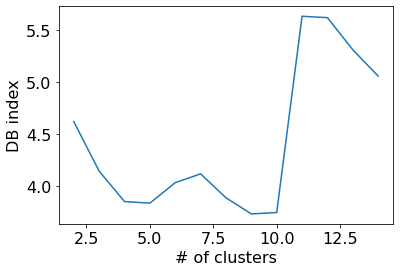

In [167]:
from sklearn.metrics import davies_bouldin_score

result_n = []
for n_clusters in range(2, 15):
    db_index = davies_bouldin_score(CER_rs_n_p1_recon, clusterig_result['euc_n_p1_'+str(n_clusters)])
    result_n.append(db_index)

plt.figure()
plt.plot(range(2, 15), result_n)
plt.xlabel('# of clusters')
plt.ylabel('DB index')
plt.show()


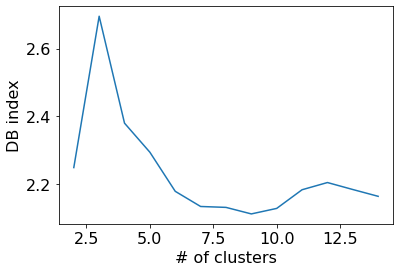

In [169]:
from sklearn.metrics import davies_bouldin_score

result_n = []
for n_clusters in range(2, 15):
    db_index = davies_bouldin_score(CER_rs_n_p1, clusterig_result['euc_n_p1_'+str(n_clusters)])
    result_n.append(db_index)

plt.figure()
plt.plot(range(2, 15), result_n)
plt.xlabel('# of clusters')
plt.ylabel('DB index')
plt.show()


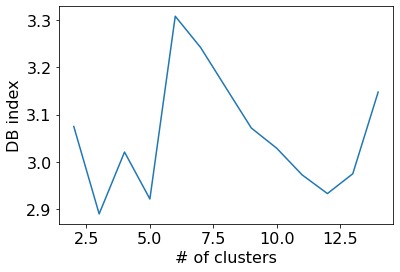

In [172]:
from sklearn.metrics import davies_bouldin_score

result_n = []
for n_clusters in range(2, 15):
    db_index = davies_bouldin_score(CER_rs_n_p2_recon, clusterig_result['euc_n_p2_'+str(n_clusters)])
    result_n.append(db_index)

plt.figure()
plt.plot(range(2, 15), result_n)
plt.xlabel('# of clusters')
plt.ylabel('DB index')
plt.show()

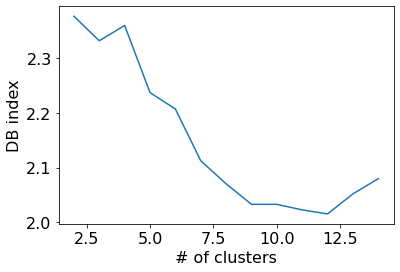

In [173]:
from sklearn.metrics import davies_bouldin_score

result_n = []
for n_clusters in range(2, 15):
    db_index = davies_bouldin_score(CER_rs_n_p2, clusterig_result['euc_n_p2_'+str(n_clusters)])
    result_n.append(db_index)

plt.figure()
plt.plot(range(2, 15), result_n)
plt.xlabel('# of clusters')
plt.ylabel('DB index')
plt.show()

In [ ]:
for n_clusters in tqdm(range(20)):
    # 1. KMeans
    model = TimeSeriesKMeans(n_clusters = n_clusters, metric = 'euclidean', \
        max_iter = 10000000, random_state = 0, verbose = 1, n_jobs=-1)
    result = model.fit_predict(CER_rs_n)
    model_dict['euc_n_p2_' + str(n_clusters)] = model
    clusterig_result['euc_n_p2_' + str(n_clusters)] = result

In [ ]:
label = CER_label['Q13'].values
CER_recon = CER_rs_n * (max_ - min_) + min_ # inverse normalization
unique_home_arr = np.unique(home_arr_n)
rep_load_list, label_list = [], []
for h in unique_home_arr:
    idx1 = home_arr_n == h
    v, c= np.unique(clusterig_result['euc_n_14'][idx1], return_counts=True)
    rep_c = v[np.argmax(c)]
    idx2 = clusterig_result['euc_n_14'] == rep_c

    # idx = idx1 * idx2
    idx = idx2

    rep_load_list.append(CER_recon[idx,:].mean(axis=0))
    label_list.append(label[h])

rep_load_dict['kmeans-14 + N'] = np.array(rep_load_list)
label_dict['kmeans-14 + N'] = np.array(label_list)
n_points_list.append(len(rep_load_list))